# Testing SAM over the Turtle Dataset

Installing and importing required dependencies and libraries

In [1]:

# pip install torch==1.11.0+cu113 torchvision==0.12.0+cu113 torchaudio==0.11.0 -f https://download.pytorch.org/whl/torch_stable.html
# pip install opencv-python pycocotools matplotlib onnxruntime onnx
# pip install git+https://github.com/facebookresearch/segment-anything.git

In [ ]:
# Download SAM the model
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

In [2]:
import torch
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2
import sys
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor
from PIL import Image

/home/alvaro.berobide/.conda/envs/env310/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Device is ', device)

Device is  cuda


In [3]:
# This function visualizes annotations on an image. It will be used later in the model for the masks.
# Each annotation is represented by a randomly colored area, each one corresponding to a segmentation mask

def show_anns(anns): 
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

In [7]:
# Reading an image form the dataset.

image = cv2.imread('Turtle_image_SAM.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

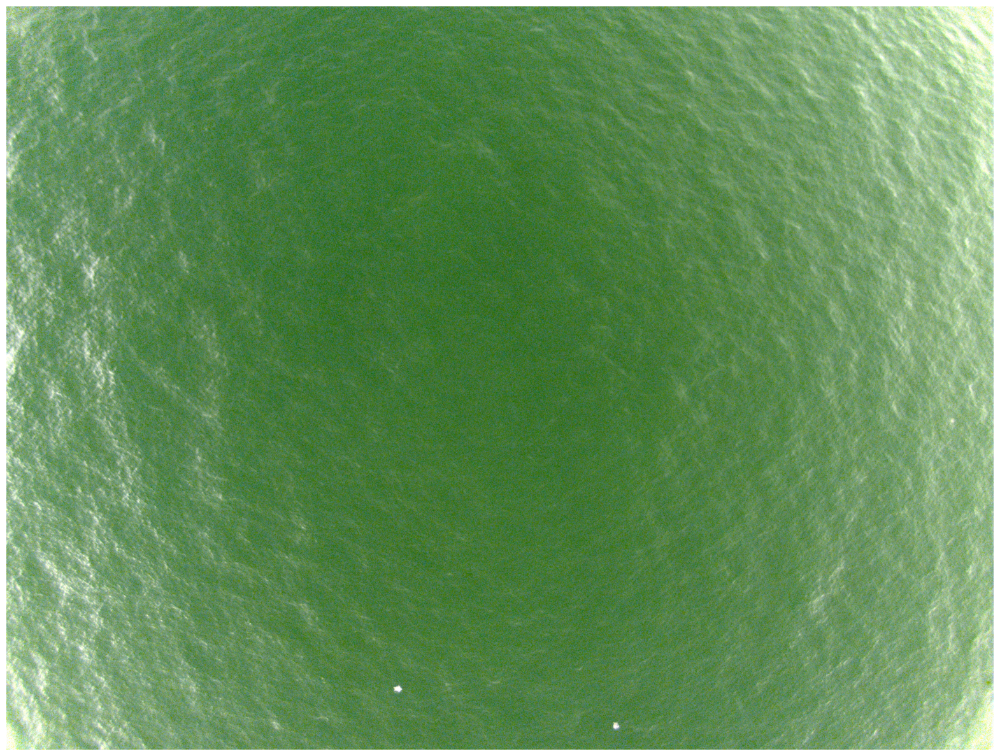

In [8]:
# Plotting the image

plt.figure(figsize=(20,20))
plt.imshow(image)
plt.axis('off')
plt.show()

In [4]:
# This section is setting up the SAM model, and configuring it to run on the GPU

sys.path.append("..")

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

mask_generator = SamAutomaticMaskGenerator(sam)

In [10]:
# Generating the mask over the imported image

masks = mask_generator.generate(image)

In [11]:
# Printing the number of masks generated, and the key of the elements stored in the mask

print(len(masks))
print(masks[0].keys())


3
dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box'])


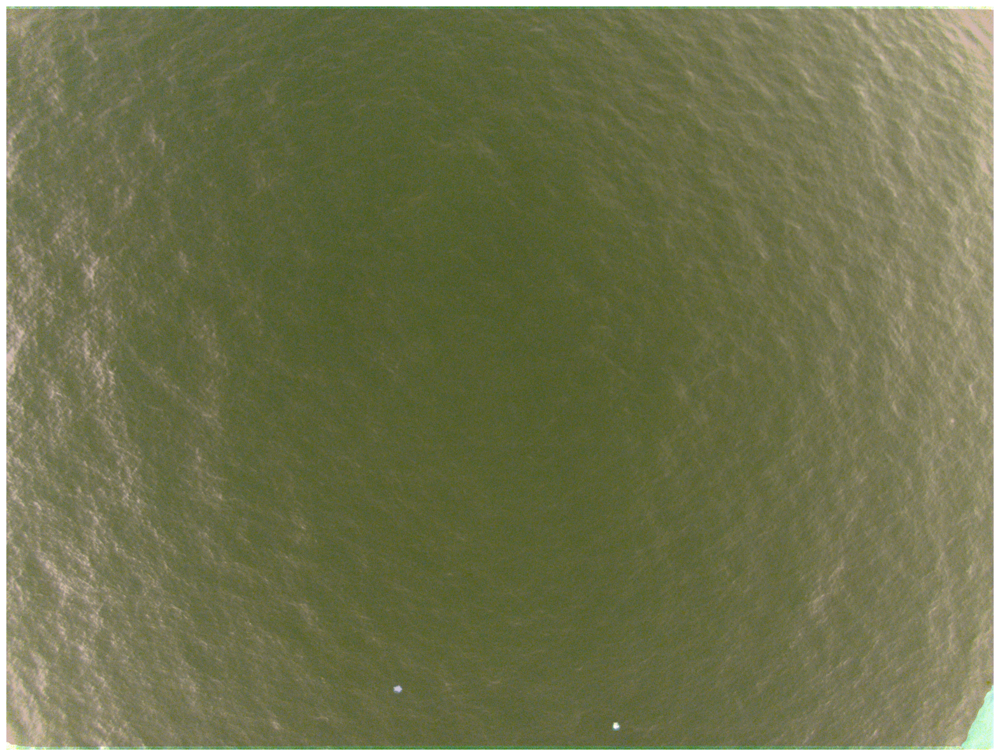

In [12]:


plt.figure(figsize=(20,20))
plt.imshow(image)
show_anns(masks)
plt.axis('off')
plt.show() 



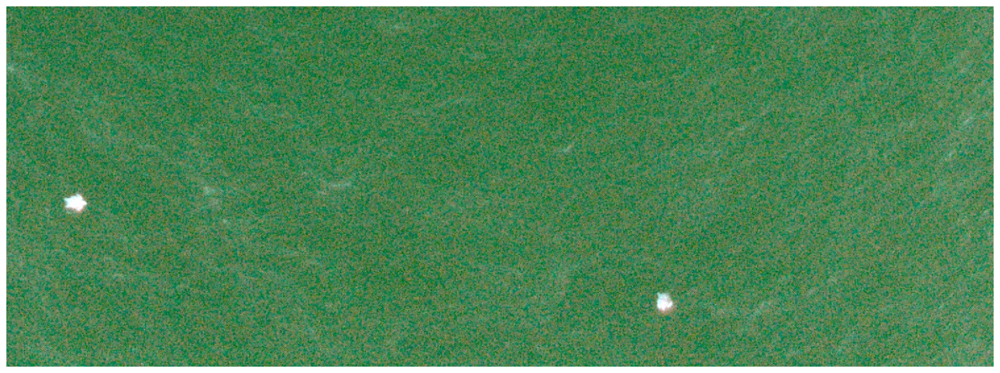

In [13]:
# Now we will work with the same image but cropped, focusing on the turtles 

crop_area = (2500, 3500, 1500, 3000)

cropped_image = image[crop_area[0]:crop_area[1], crop_area[2]:crop_area[3]]

cropped_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)


# Plotting the image
plt.figure(figsize=(20,20))
plt.imshow(cropped_image)
plt.axis('off')
plt.show()


3


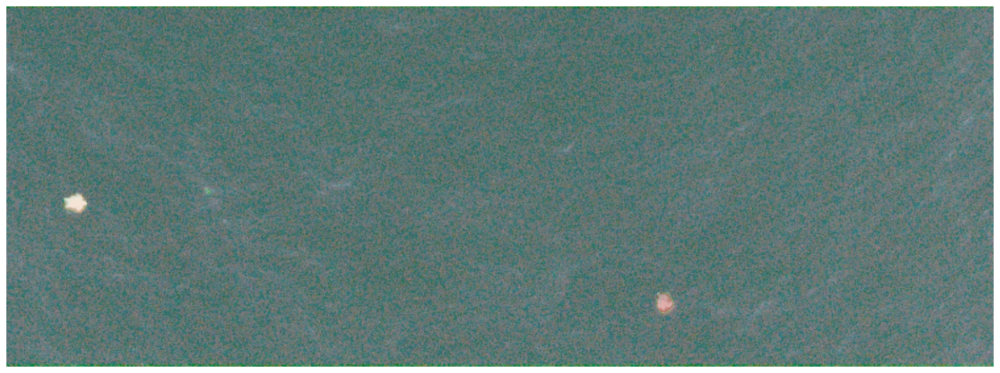

In [14]:
# Generating the mask over the imported image

masks = mask_generator.generate(cropped_image)

# Printing the number of masks generatedk

print(len(masks))

#Plotting the image with the resulting masks

plt.figure(figsize=(20,20))
plt.imshow(cropped_image)
show_anns(masks)
plt.axis('off')
plt.show() 




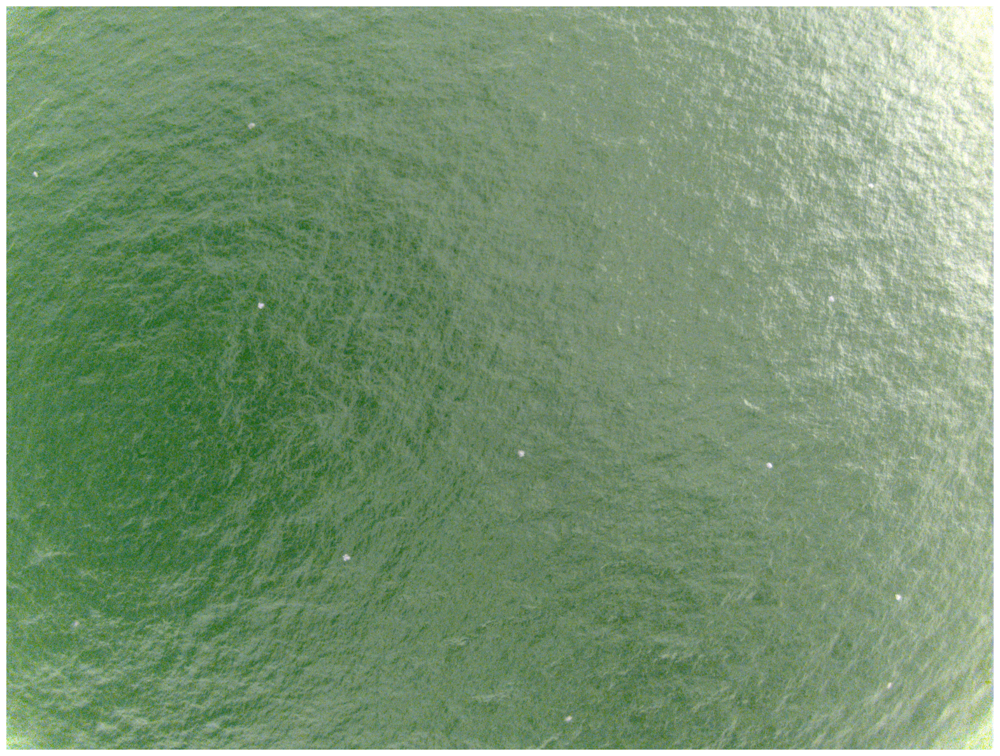

1


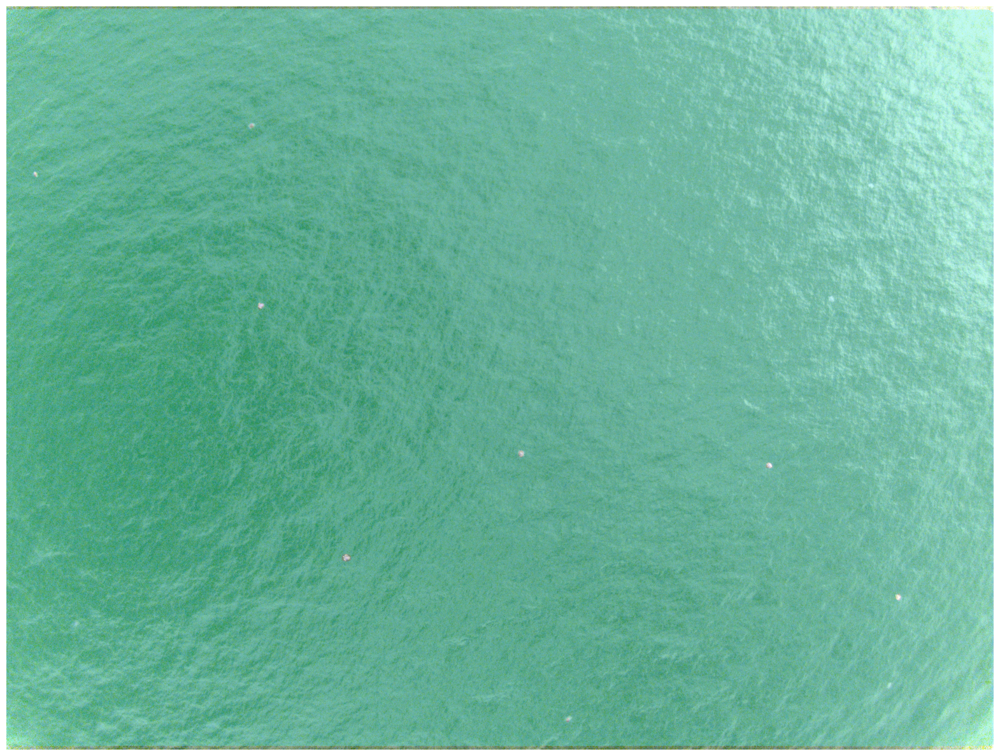

In [15]:
# Reading an image form the dataset.

image = cv2.imread('Turtle_image_SAM_2.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


# Plotting the image

plt.figure(figsize=(20,20))
plt.imshow(image)
plt.axis('off')
plt.show()


# Generating the mask over the imported image

masks = mask_generator.generate(image)

# Printing the number of masks generatedk

print(len(masks))

#Plotting the image with the resulting masks

plt.figure(figsize=(20,20))
plt.imshow(image)
show_anns(masks)
plt.axis('off')
plt.show() 


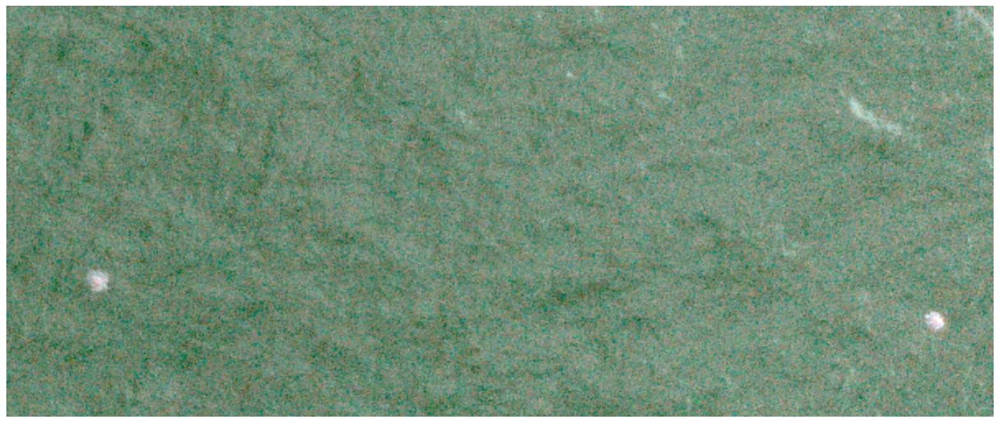

In [12]:
# Now we will work with the same image but cropped, focusing on some the turtles 

crop_area = (1500, 2000, 2000, 3200)

cropped_image = image[crop_area[0]:crop_area[1], crop_area[2]:crop_area[3]]

cropped_image = cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB)


# Plotting the image
plt.figure(figsize=(20,20))
plt.imshow(cropped_image)
plt.axis('off')
plt.show()


6


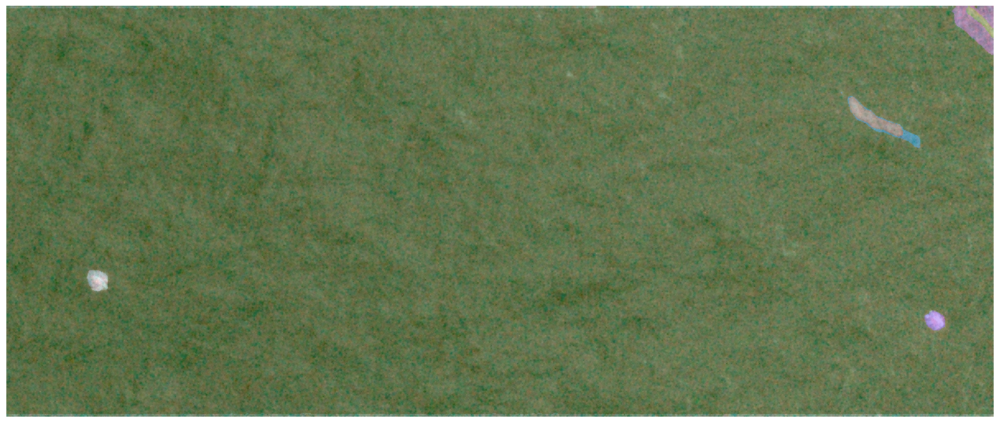

In [13]:
# Generating the mask over the imported image

masks = mask_generator.generate(cropped_image)

# Printing the number of masks generatedk

print(len(masks))

#Plotting the image with the resulting masks

plt.figure(figsize=(20,20))
plt.imshow(cropped_image)
show_anns(masks)
plt.axis('off')
plt.show() 


--2023-11-26 03:21:39--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_l_0b3195.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.160.69.104, 3.160.69.90, 3.160.69.117, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.160.69.104|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1249524607 (1.2G) [binary/octet-stream]
Saving to: ‘sam_vit_l_0b3195.pth’

sam_vit_l_0b3195.pt 100%[===================>]   1.16G   212MB/s    in 6.1s    

2023-11-26 03:21:45 (195 MB/s) - ‘sam_vit_l_0b3195.pth’ saved [1249524607/1249524607]

